In [1]:
import folium
import pandas as pd
# from matplotlib import colormaps, colors

df = pd.read_csv('eda_clean.csv')

In [2]:
# create map using folium with coordinates of Seattle city center
city_center = [47.6050242, -122.3343709]
m = folium.Map(location=city_center, control_scale=True, zoomstart=13)

median_price = df['price'].median()

# adding circles at house locations with color depending on house price
for _, row in df.iterrows():
    
    above = row['price'] >= median_price
    if above == True:
        color = 'blue'
    else:
        color = 'red'

    # add circle
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=2,
        popup=f"Price: $ {row['price']:,}\nDistance Center: {round(row['dist_center'], 2)}",
        color=color,
        stroke=False,
        fill=True,
        fill_opacity=0.3
    ).add_to(m)

folium.Circle(
    location=city_center,
    radius=14003,
    popup="Above median price",
    color="#463FFF",
    fill=False
).add_to(m)

folium.Circle(
    location=city_center,
    radius=19463,
    popup="Below median price",
    color="#FB5454",
    fill=False
).add_to(m)

# add circle for city center
folium.CircleMarker(
    location=city_center,
    radius=15,
    popup="City Center",
    color="black",
    fill=True,
    fill_opacity=0.6
).add_to(m)

# showing map
m

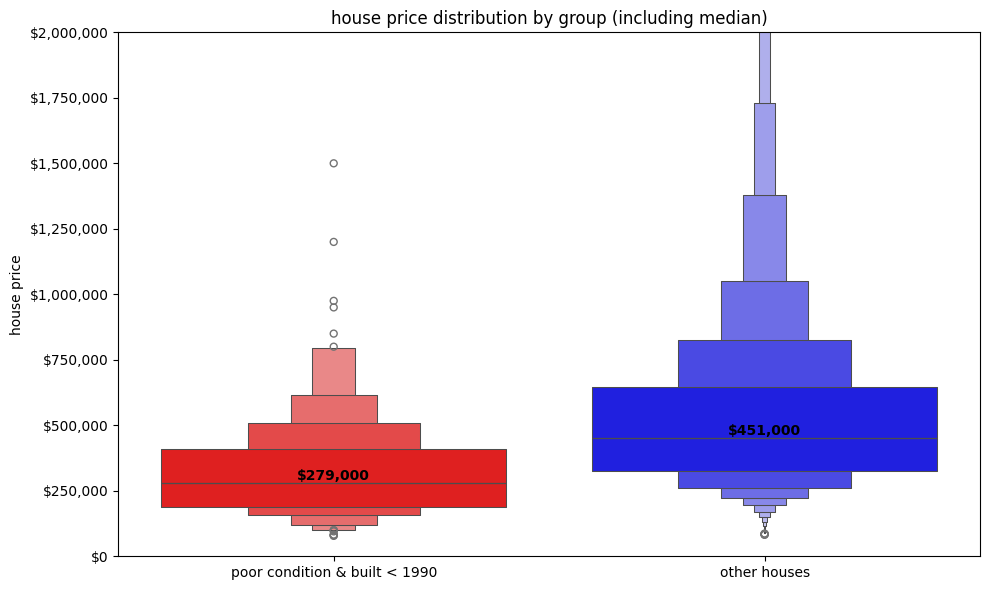

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter

old_poor_condition_houses = df[(df['condition'] < 3) & (df['yr_built'] < 1990)]
other_houses = df[(df['condition'] >= 3) | (df['yr_built'] >= 1990)]
old_poor_median = old_poor_condition_houses['price'].median()
other_median = other_houses['price'].median()

# Create a combined dataframe for plotting
df_plot = pd.concat([
    old_poor_condition_houses.assign(group='poor condition & built < 1990'),
    other_houses.assign(group='other houses')
])

plt.figure(figsize=(10,6))

sns.boxenplot(
    data=df_plot,
    x='group', 
    y='price',
    palette=['red', 'blue'],
    hue='group',
    legend=False
)

# Format y-axis as dollars
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda y, _: f'${y:,.0f}'))

# Add median annotations
plt.text(
    x=0, y=old_poor_median, 
    s=f"${old_poor_median:,.0f}", 
    color='black', ha='center', va='bottom', fontweight='bold'
)

plt.text(
    x=1, y=other_median, 
    s=f"${other_median:,.0f}", 
    color='black', ha='center', va='bottom', fontweight='bold'
)

plt.ylim(0, 2_000_000)  # optional: cap at $3M like before
plt.xlabel('')
plt.ylabel('house price')
plt.title('house price distribution by group (including median)')
plt.tight_layout()
plt.show()